# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary.


Using the vehicles.csv dataset that contains "used car" details, develop a regression model to predict vehicle price based on features like year, manufacturer, model,condition,odometer etc,
Evaluate which feature is important and select important features that are valued the most in deciding the used car prices. Also, quantify their impact on the price of an used car.
This analysis should help in the identification of the most influential factors for used car valuation.

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [177]:
# Import all libraries needed and read the csv files
!pip install category_encoders

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import plotly.express as px

import re
import warnings

from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import Lasso
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.utils import shuffle
from sklearn.metrics import mean_squared_error, r2_score
import category_encoders as ce
from sklearn.impute import SimpleImputer
warnings.filterwarnings('ignore')




In [178]:
vehicles=pd.read_csv('data/vehicles.csv')
vehicles.sample(40)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
215235,7315965063,minneapolis / st paul,18775,2019.0,kia,sportage ex,excellent,4 cylinders,gas,24566.0,rebuilt,automatic,NaN,4wd,mid-size,SUV,black,mn
213231,7314766827,mankato,11989,2016.0,nissan,rogue,NaN,NaN,gas,129697.0,clean,automatic,5N1AT2MV1GC923055,NaN,NaN,NaN,black,mn
285318,7311684142,new hampshire,23995,2014.0,gmc,sierra 1500,excellent,NaN,gas,102000.0,clean,automatic,1GTV2UECXEZ381787,4wd,NaN,pickup,green,nh
251818,7306913261,central NJ,27990,2013.0,NaN,International 4300,good,8 cylinders,diesel,117550.0,clean,automatic,1HTJTSKM7DH258632,rwd,full-size,truck,white,nj
389428,7313305972,charlottesville,4900,2006.0,NaN,saab 9-3 2.0t,good,4 cylinders,gas,115000.0,salvage,automatic,NaN,fwd,mid-size,sedan,silver,va
203118,7313771248,holland,26990,2016.0,ford,f150 regular cab xl pickup,good,6 cylinders,gas,14230.0,clean,other,1FTMF1CP3GKD62143,NaN,NaN,pickup,black,mi
72481,7316930569,colorado springs,39990,2020.0,tesla,model 3 standard range,good,NaN,other,14044.0,clean,other,5YJ3E1EA9LF598424,NaN,NaN,sedan,NaN,co
28902,7302557771,gold country,101,2008.0,mercury,grand marquis,NaN,8 cylinders,gas,29300.0,clean,automatic,2MEFM74V28X608790,rwd,NaN,sedan,NaN,ca
304973,7314938064,oklahoma city,16995,2013.0,chevrolet,silverado,NaN,NaN,other,75259.0,clean,automatic,1GCRCPEA1DZ161516,fwd,NaN,pickup,white,ok
85843,7302832028,hartford,7500,1973.0,NaN,Plymouth Duster,good,6 cylinders,gas,87000.0,clean,automatic,NaN,rwd,NaN,sedan,yellow,ct


In [86]:
# To understand the data view few records and the know all the column information and their statistics

vehicles.info()

vehicles.describe(include='object')


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

,region,manufacturer,model,condition,cylinders,fuel,title_status,transmission,VIN,drive,size,type,paint_color,state
count,426880,409234,421603,252776,249202,423867,418638,424324,265838,296313,120519,334022,296677,426880
unique,404,42,29649,6,8,5,6,3,118246,3,4,13,12,51
top,columbus,ford,f-150,good,6 cylinders,gas,clean,automatic,1FMJU1JT1HEA52352,4wd,full-size,sedan,white,ca
freq,3608,70985,8009,121456,94169,356209,405117,336524,261,131904,63465,87056,79285,50614


In [87]:

#  Investigate Data Distribution and Outliers:

vehicles_region = vehicles.groupby(['year', 'state','region']).sum().reset_index()

px.line(vehicles_region, x = 'year',y= 'price', color = 'state')

In [88]:
px.line(vehicles, x = 'odometer',y= 'price',color='region')

In [89]:
vehicles.isna().sum()

,0
id,0
region,0
price,0
year,1205
manufacturer,17646
model,5277
condition,174104
cylinders,177678
fuel,3013
odometer,4400


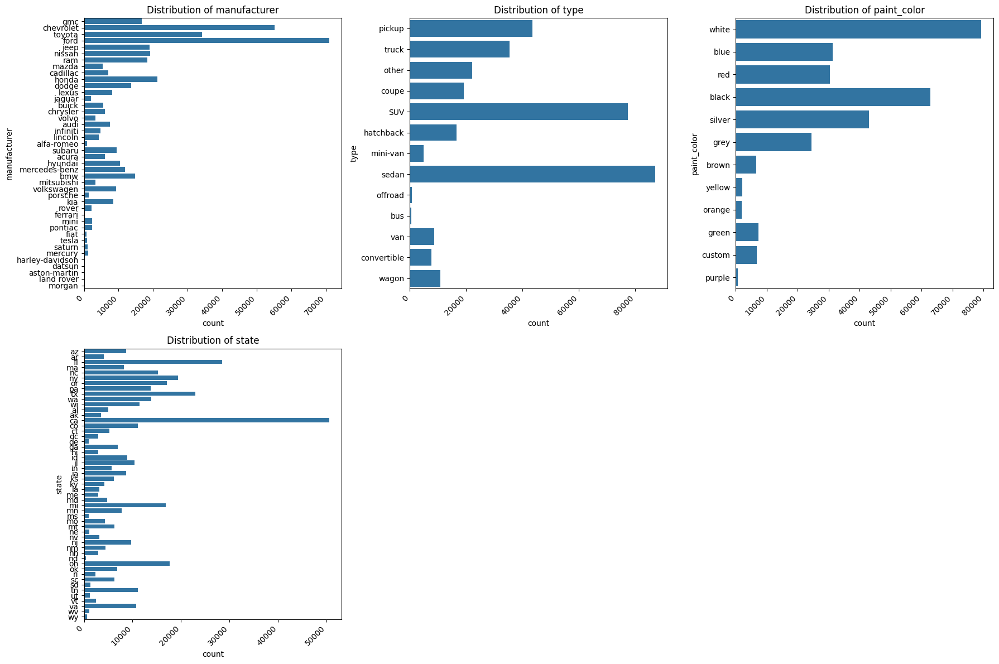

In [90]:
category_columns = ['manufacturer',  'type', 'paint_color', 'state']
# model and state have not been considered in the category -> Reason being count of unique models and unique states are more, matplot could not bind them in one figure

num_cols = 3
num_rows = int(np.ceil(len(category_columns) / num_cols))

plt.figure(figsize=(18, 6 * num_rows))

for i, col in enumerate(category_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.title(f'Distribution of {col}')
    sns.countplot(y=col, data=vehicles)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
plt.show()

In [91]:
for col in vehicles.columns:
    print(col,vehicles[col].nunique())


id 426880
region 404
price 15655
year 114
manufacturer 42
model 29649
condition 6
cylinders 8
fuel 5
odometer 104870
title_status 6
transmission 3
VIN 118246
drive 3
size 4
type 13
paint_color 12
state 51


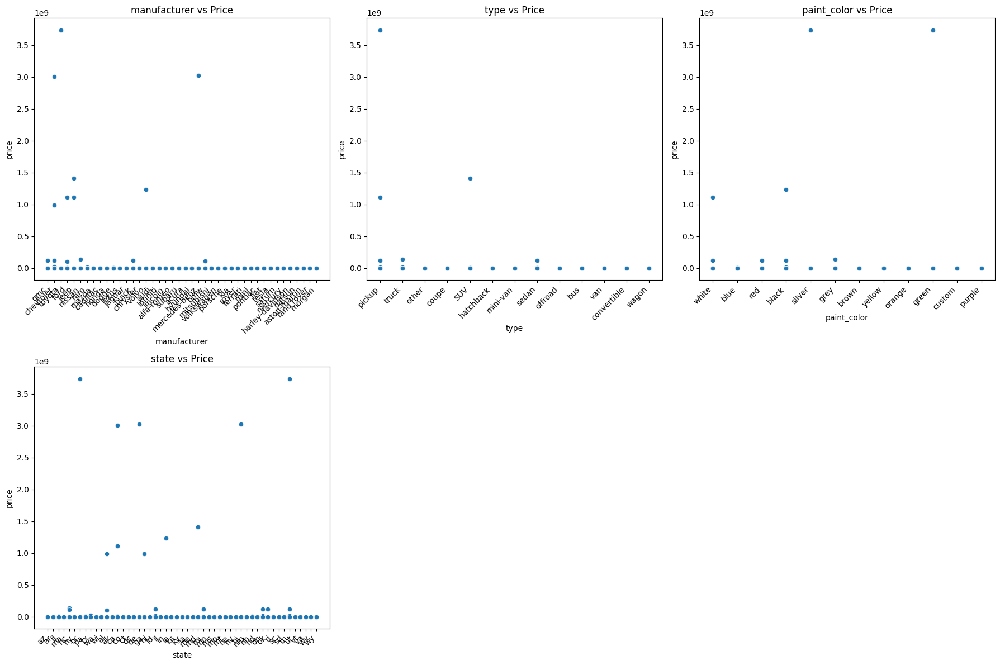

In [92]:

num_cols = 3
num_rows = int(np.ceil(len(category_columns) / num_cols))

plt.figure(figsize=(18, 6 * num_rows))

for i, col in enumerate(category_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.title(f'{col} vs Price')
    sns.scatterplot(x=vehicles[col], y=vehicles['price'])
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
plt.show()


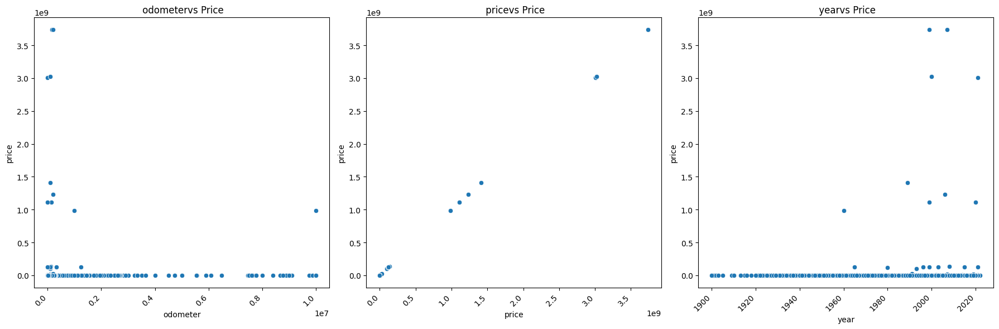

In [93]:
num_cols = 3
numerical_columns = ['odometer','price','year']

num_rows = int(np.ceil(len(numerical_columns) / num_cols))

plt.figure(figsize=(18, 6 * num_rows))

for i, col in enumerate(numerical_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.title(f' {col}vs Price')
    sns.scatterplot(x=vehicles[col], y=vehicles['price'])
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
plt.show()

In [94]:
vehicle_condition_transmission = vehicles.groupby(['condition','title_status','type'])[['price']].sum().reset_index()

px.line(vehicle_condition_transmission, x = ['condition','title_status'],y= 'price', color = 'type')

# shows that pickup cars has relatively high price value than the hatchback,sedan,van etc


In [96]:

vehicles[numerical_columns].corr()


,odometer,price,year
odometer,1.000000,0.010032,-0.157215
price,0.010032,1.000000,-0.004925
year,-0.157215,-0.004925,1.000000


In [97]:
#  price has  more correlation with year when compared to odometer of the vehicle
print((vehicles[numerical_columns].corr()[['price']]).nlargest(n=3,columns='price').index[2])

year


In [98]:
pd.crosstab(vehicles['price'],vehicles['manufacturer'])


manufacturer,acura,alfa-romeo,aston-martin,audi,bmw,buick,cadillac,chevrolet,chrysler,datsun,...,pontiac,porsche,ram,rover,saturn,subaru,tesla,toyota,volkswagen,volvo
price,,,,,,,,,,,,,,,,,,,,,
0,271,27,3,393,954,317,362,4421,375,0,...,58,80,1878,121,18,509,21,2602,447,96
1,10,0,0,26,131,21,28,260,26,2,...,8,12,76,13,0,23,4,123,12,3
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,7,0,1,1,0
3,0,0,0,0,1,0,0,3,1,0,...,1,0,0,0,0,0,0,1,0,0
4,0,0,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1234567890,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1410065407,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3009548743,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


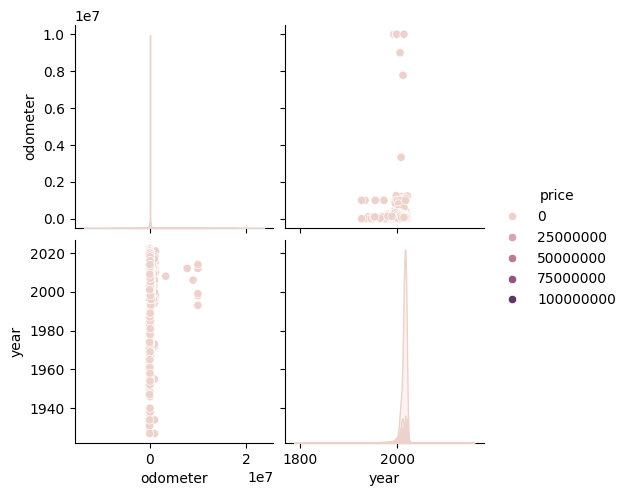

In [99]:
numerical_columns = ['odometer','price','year']

sns.pairplot(vehicles[numerical_columns].sample(n=10000), hue='price')  # Sample 10000 rows
plt.show()

In [100]:

#  Explore Data Types and Unique Values:
for col in numerical_columns:
    print(col)
    print(vehicles[col].value_counts())
print('Category Columns')
for col in category_columns:
    print(col)
    print(vehicles[col].value_counts())

odometer
odometer
100000.0    2263
1.0         2246
0.0         1965
200000.0    1728
150000.0    1603
            ... 
149468.0       1
154259.0       1
111887.0       1
213826.0       1
26892.0        1
Name: count, Length: 104870, dtype: int64
price
price
0        32895
6995      3169
7995      3129
9995      2867
8995      2837
         ...  
21298        1
49217        1
63195        1
19709        1
17873        1
Name: count, Length: 15655, dtype: int64
year
year
2017.0    36420
2018.0    36369
2015.0    31538
2013.0    30794
2016.0    30434
          ...  
1943.0        1
1915.0        1
1902.0        1
1905.0        1
1909.0        1
Name: count, Length: 114, dtype: int64
Category Columns
manufacturer
manufacturer
ford               70985
chevrolet          55064
toyota             34202
honda              21269
nissan             19067
jeep               19014
ram                18342
gmc                16785
bmw                14699
dodge              13707
mercedes-benz    

### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`.

In [179]:
#Drop columns id,VIN as they are only identification numbers that dont help to know the price
vehicles=vehicles.drop(columns=['id','VIN'])
# drop columns with number of unique values less than 10
# drop size column as it contain almost 90% of data as null. So, it cannot contribute anything to the model.

vehicles=vehicles.drop(columns=['cylinders','condition','title_status','transmission','drive','size','fuel'])


# create column named age, to understand how old is the car instead of year
vehicles['age']=2025-vehicles['year']
vehicles=vehicles.drop(columns=['year'])

# convert all categorical columns to string

categorical_columns = ['region','manufacturer', 'model', 'type','paint_color','state']
vehicles.convert_dtypes()

for col in categorical_columns:
    vehicles[col] = vehicles[col].astype('string')



In [103]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 424915 entries, 0 to 426879
Data columns (total 9 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        424915 non-null  string 
 1   price         424915 non-null  float64
 2   manufacturer  424915 non-null  string 
 3   model         424915 non-null  object 
 4   odometer      424915 non-null  float64
 5   type          424915 non-null  string 
 6   paint_color   424915 non-null  string 
 7   state         424915 non-null  string 
 8   age           424915 non-null  float64
dtypes: float64(3), object(1), string(5)
memory usage: 32.4+ MB


In [180]:
# remove null records from dataset and replacing with either median/mode of that column to avoid losing data

vehicles=vehicles[vehicles['odometer']!=0] # If odometer=0, it cannot be used car.So removing those records
vehicles['odometer'].fillna(vehicles['odometer'].median(), inplace=True)
vehicles['age'].fillna(vehicles['age'].median(), inplace=True)
vehicles['manufacturer'].fillna(vehicles['manufacturer'].mode()[0], inplace=True)
vehicles['model'].fillna(vehicles['model'].mode()[0], inplace=True)
vehicles['type'].fillna(vehicles['type'].mode()[0], inplace=True)
vehicles['paint_color'].fillna(vehicles['paint_color'].mode()[0], inplace=True)
vehicles['state'].fillna(vehicles['state'].mode()[0], inplace=True)
vehicles['region'].fillna(vehicles['region'].mode()[0], inplace=True)
vehicles['model'] = vehicles['model'].apply(lambda x: re.sub(r'\$', '', str(x)))  # Apply regex to replace $
# This shows price column has value equal to zero. There cannot be a car that a dealer would sell for price zero. So, encoding all the records that have zero value with mean of price.
vehicles['price'] = vehicles['price'].replace(0, vehicles['price'].mean())

In [104]:

px.pie(vehicles, names = 'type',values= 'price', color = 'type')


In [181]:

# Remove Outliers in price:
# Identify and remove outliers in price using the IQR method or other methods.
Q1 = vehicles['price'].quantile(0.25)
Q3 = vehicles['price'].quantile(0.75)
IQR = Q3 - Q1
vehicles = vehicles[~((vehicles['price'] < (Q1 - 1.5 * IQR)) | (vehicles['price'] > (Q3 + 1.5 * IQR)))]
vehicles.shape

(388278, 9)

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [182]:
categorical_features_jamesStein_encoding= ['manufacturer', 'model', 'state','region', 'type']
numerical_features = ['odometer', 'age']

# Create transformers
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

categorical_jamesSteinencoding_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),  # Impute missing values with the most frequent category
    ('label', ce.JamesSteinEncoder())
])

# Combine transformers using ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features),
        ('catlabel',categorical_jamesSteinencoding_transformer,categorical_features_jamesStein_encoding),
        ('poly', PolynomialFeatures(degree=1,include_bias = False), numerical_features)
    ])



In [183]:
#Transform the data with appropriate transformers and encoders
X=vehicles.drop('price', axis=1)
y=vehicles['price']
preprocessed_vehicles=preprocessor.fit_transform(X,y)

In [109]:
preprocessed_vehicles.shape

(388278, 9)

In [184]:
#Trainset and Test set splitting by 80-20
vehicles_trainset, vehicles_testset, vehicles_price_trainset, vehicles_price_testset = train_test_split(preprocessed_vehicles, y, test_size=0.2, random_state=42)

In [185]:
# Linear Regression

linreg=LinearRegression(fit_intercept=False)
linreg.fit(vehicles_trainset,vehicles_price_trainset)


LinearRegression(fit_intercept=False)

In [186]:
price_test_pred=linreg.predict(vehicles_testset)
price_train_pred=linreg.predict(vehicles_trainset)

In [187]:
vehicles_price_testset.values[0:5]

array([44839., 21500.,  9000.,  6995.,  9995.])

In [188]:
price_test_pred[0:5]

array([32019.16575388, 12126.66495551,  5317.08090965, 10715.00021357,
       10391.40331689])

In [189]:
rmse_vehicles_testdata = np.sqrt(mean_squared_error(vehicles_price_testset, price_test_pred))
print(f'RMSE: {rmse_vehicles_testdata}')
#Model will have an error of 8194$ for every prediction that it makes with testing set

RMSE: 8194.871319397364


In [190]:
rmse_vehicles_traindata = np.sqrt(mean_squared_error(vehicles_price_trainset, price_train_pred))
print(f'RMSE: {rmse_vehicles_testdata}')

#Model will have an error of 8194$ for every prediction that it makes with training set

RMSE: 8194.871319397364


In [191]:
r2_test = r2_score(vehicles_price_testset, price_test_pred)
print(f'R²: {r2_test}')

# 62% of the data can be predicted correctly with Linear Regression model

R²: 0.6232595992872857


In [192]:
coefs=linreg.coef_
coefs=coefs[:-1]
name_all_columns=X.columns
for name, coef in zip(name_all_columns,coefs ):
    print(f"Feature: {name:<20} Coefficient: {coef:.4f}")

yintercept = linreg.intercept_
print(f"Intercept: {yintercept:.2f}")

Feature: region               Coefficient: 4737.3509
Feature: manufacturer         Coefficient: 14258.2752
Feature: model                Coefficient: 0.2502
Feature: odometer             Coefficient: 0.9516
Feature: type                 Coefficient: 0.5202
Feature: paint_color          Coefficient: 0.4608
Feature: state                Coefficient: 0.3414
Feature: age                  Coefficient: -0.0271
Intercept: 0.00


In [193]:
#Performing 5 fold cross validation for Linear Regression
param_grid={'fit_intercept':[False],'positive':[True]}

grid_search = GridSearchCV(linreg, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(vehicles_trainset, vehicles_price_trainset)

# Get the best hyperparameters
best_params = grid_search.best_params_

# Get the best model
best_model = grid_search.best_estimator_
grid_search.cv_results_

{'mean_fit_time': array([0.06881428]),
 'std_fit_time': array([0.01066485]),
 'mean_score_time': array([0.00490737]),
 'std_score_time': array([0.00048139]),
 'param_fit_intercept': masked_array(data=[False],
              mask=[False],
        fill_value=True),
 'param_positive': masked_array(data=[True],
              mask=[False],
        fill_value=True),
 'params': [{'fit_intercept': False, 'positive': True}],
 'split0_test_score': array([-75617615.63131748]),
 'split1_test_score': array([-75422881.40303704]),
 'split2_test_score': array([-74715563.4386345]),
 'split3_test_score': array([-76305487.86288317]),
 'split4_test_score': array([-74941634.94829053]),
 'mean_test_score': array([-75400636.65683255]),
 'std_test_score': array([556118.3852257]),
 'rank_test_score': array([1], dtype=int32)}

In [194]:
grid_search.best_estimator_
# indicates that Linear Regression with fit_intercetFalse and positive True is good estimator with score of 57%


LinearRegression(fit_intercept=False, positive=True)

In [195]:
best_model.predict(vehicles_testset)
best_model.score(vehicles_testset,vehicles_price_testset)

#Score is 57%


0.5706498789416599

In [196]:
#  To try Polynomial with all degree 5 and see the best degree , shuffling the training set and test set with 80-20
all_indices =range(0,len(vehicles))
all_indices=shuffle(all_indices)

training_indices=all_indices[:int(len(all_indices)*0.8)]
test_indices=all_indices[int(len(all_indices)*0.8):]
vehicles_trainset=vehicles.iloc[training_indices]
vehicles_testset=vehicles.iloc[test_indices]
vehicles_trainset.drop('price',axis=1)
vehicles_testset.drop('price',axis=1)

vehicles_price_trainset=vehicles['price'].iloc[training_indices]
vehicles_price_testset=vehicles['price'].iloc[test_indices]

In [197]:

# Perform Linear Regression with Polynomial Features of degree 1-5 and find the best degree
train_mses = []
test_mses = []
features=['model','manufacturer','odometer','age','region','state','type']
for i in range(1, 6):

    preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features),
        ('catlabel',categorical_jamesSteinencoding_transformer,categorical_features_jamesStein_encoding),
        ('poly', PolynomialFeatures(degree=i,include_bias = False), numerical_features)
    ])


    poly_transformer = make_column_transformer((PolynomialFeatures(degree=i), make_column_selector(dtype_include=np.number)),
                                           (ce.JamesSteinEncoder(), ['model','manufacturer','region','state','type']),
                      )


    linear_alldegrees_model = Pipeline([('transformer', poly_transformer),
                  ('linreg', LinearRegression())])
    #fit on train
    linear_alldegrees_model.fit(vehicles_trainset[features],vehicles_price_trainset)

    #predict on train and test
    train_preds=linear_alldegrees_model.predict(vehicles_trainset)
    test_preds=linear_alldegrees_model.predict(vehicles_testset)


    #compute mean squared errors
    train_mse=mean_squared_error(train_preds,vehicles_price_trainset)
    test_mse=mean_squared_error(test_preds,vehicles_price_testset)


    #append to train_mses and test_mses respectively
    train_mses.append(train_mse)
    test_mses.append(test_mse)


linear_alldegrees_model_best_degree = test_mses.index(min(test_mses))+1
linear_alldegrees_model_best_mse = float(min(test_mses))


In [198]:
print(linear_alldegrees_model_best_degree)
print(linear_alldegrees_model_best_mse)
#Linear Regression degree 2  is best

2
72338666.07378627


In [199]:
# Ridge REgression with degree 2

poly_transformer_degree2 = make_column_transformer((PolynomialFeatures(degree=2), make_column_selector(dtype_include=np.number)),
                                        (ce.JamesSteinEncoder(), ['model','manufacturer','region','state','type']),
                  )

ridge_pipe = Pipeline([('transformer', poly_transformer_degree2),
            ('ridge', Ridge())])
param_grid = {'ridge__alpha': [0.001, 0.1, 1.0, 10.0, 100.0, 1000.0]}

ridge_grid = GridSearchCV(ridge_pipe,param_grid=param_grid)
ridge_grid.fit(vehicles_trainset[features],vehicles_price_trainset)
train_preds = ridge_grid.predict(vehicles_trainset[features])
test_preds = ridge_grid.predict(vehicles_testset[features])
ridge_model_train_mse = mean_squared_error(vehicles_price_trainset,train_preds)
ridge_model_test_mse = mean_squared_error(vehicles_price_testset,test_preds)
ridge_model_best_alpha = ridge_grid.best_params_


# Answer check
print(f'Test MSE: {ridge_model_test_mse}')
print(f'Best Alpha: {list(ridge_model_best_alpha.values())[0]}')
# Mean Square error has reduced to 64050561 when compared to  degree2 polynomial LinearRegreesion model
#Hyper parameter alpha .001 turned out to  have low mean square error


Test MSE: 63231491.390130736
Best Alpha: 0.001


In [200]:
ridge_grid.best_estimator_

Pipeline(steps=[('transformer',
                 ColumnTransformer(transformers=[('polynomialfeatures',
                                                  PolynomialFeatures(),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7ee2cf573c10>),
                                                 ('jamessteinencoder',
                                                  JamesSteinEncoder(),
                                                  ['model', 'manufacturer',
                                                   'region', 'state',
                                                   'type'])])),
                ('ridge', Ridge(alpha=0.001))])

In [201]:
ridge_grid.best_estimator_.score(vehicles_testset[features],vehicles_price_testset)
#Ridge grid had score of 64% when compared to Linear REgression which is 57%

0.6429116553954903

In [202]:
poly_2 = PolynomialFeatures(degree=2, include_bias=False)
poly_2_numericfeatures = poly_2.fit_transform(vehicles[['odometer','age']])

df_poly_2_numericfeatures = pd.DataFrame(poly_2_numericfeatures, columns=poly_2.get_feature_names_out(['odometer','age']))

std_dev_poly2_numericfeatures = df_poly_2_numericfeatures.std()

std_dev_poly2_numericfeatures


,0
odometer,2.058132e+05
age,9.487805e+00
odometer^2,1.827260e+12
odometer age,9.374146e+06
age^2,6.357878e+02


In [203]:
ridge_grid.cv_results_

{'mean_fit_time': array([1.72562785, 1.95987525, 1.97370491, 2.09588423, 2.05199647,
        1.72520671]),
 'std_fit_time': array([0.17388967, 0.35884736, 0.54689192, 0.51559325, 0.39759669,
        0.10932513]),
 'mean_score_time': array([0.16596746, 0.18020005, 0.1888382 , 0.18918328, 0.19660025,
        0.18499675]),
 'std_score_time': array([0.00395275, 0.03055782, 0.04145469, 0.04457327, 0.05012334,
        0.03244142]),
 'param_ridge__alpha': masked_array(data=[0.001, 0.1, 1.0, 10.0, 100.0, 1000.0],
              mask=[False, False, False, False, False, False],
        fill_value=1e+20),
 'params': [{'ridge__alpha': 0.001},
  {'ridge__alpha': 0.1},
  {'ridge__alpha': 1.0},
  {'ridge__alpha': 10.0},
  {'ridge__alpha': 100.0},
  {'ridge__alpha': 1000.0}],
 'split0_test_score': array([0.63883558, 0.63883558, 0.63883558, 0.63883556, 0.63883531,
        0.63883284]),
 'split1_test_score': array([0.64040751, 0.6404075 , 0.6404075 , 0.64040746, 0.64040707,
        0.64040318]),
 'split2

In [204]:
# As LASSO makes coef of many features to zero, it can be used to select the features with coef>0.
# Using these columns given by lasso model, we can pass to Linear Regression model

lasso_selector_pipe = Pipeline([('transformer', poly_transformer_degree2),
                                ('selector', SelectFromModel(Lasso())),
                                ('linreg', LinearRegression())])

lasso_selector_pipe.fit(vehicles_trainset,vehicles_price_trainset)
selector_train_mse = mean_squared_error(lasso_selector_pipe.predict(vehicles_trainset),vehicles_price_trainset)
selector_test_mse = mean_squared_error(lasso_selector_pipe.predict(vehicles_testset),vehicles_price_testset)



In [205]:
#Sequential Feature Selector

sequential_pipe = Pipeline([('transformer',poly_transformer_degree2),
                            ('selector',SequentialFeatureSelector(LinearRegression(),n_features_to_select=4)),
                            ('linreg',LinearRegression())])
sequential_pipe.fit(vehicles_trainset,vehicles_price_trainset)
sequential_train_mse = mean_squared_error(vehicles_price_trainset,sequential_pipe.predict(vehicles_trainset))
sequential_test_mse =  mean_squared_error(vehicles_price_testset,sequential_pipe.predict(vehicles_testset))

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [210]:
# Linear Regression with default arguments
# Display the coefficients with corresponding Column names and unstandardize columns

std = vehicles.select_dtypes(include=['number']).std().to_frame(name='Standard Deviation').rename_axis('Feature').reset_index()

std_numerical = std[std['Feature'].isin(numerical_features)]['Standard Deviation'].values

coefs_unstandarized_numerical = coefs[:len(numerical_features)] / std_numerical

coefs_cat = coefs[len(numerical_features):]

# Put together
coefs_desst = np.concatenate([coefs_unstandarized_numerical, coefs_cat])

# Create final table
final_table = pd.DataFrame({
    'Feature': name_all_columns,
    'Standard Deviation': list(std_numerical) + ['N/A'] * 6,
    'Original Coefficients': coefs,
    'Unstandarized Coefficients': coefs_desst
})


final_table.sort_values('Unstandarized Coefficients', key=abs, ascending=False)

,Feature,Standard Deviation,Original Coefficients,Unstandarized Coefficients
1,manufacturer,9.487805,14258.275207,1502.800126
3,odometer,N/A,0.951568,0.951568
4,type,N/A,0.520182,0.520182
5,paint_color,N/A,0.460801,0.460801
6,state,N/A,0.341398,0.341398
2,model,N/A,0.250229,0.250229
7,age,N/A,-0.027111,-0.027111
0,region,205813.192754,4737.350864,0.023018


In [211]:
# Ridge REgression
# Display the coefficients with corresponding Column names and unstandardize columns
ridge_coefficients=ridge_grid.best_estimator_.named_steps['ridge'].coef_
feature_names=ridge_grid.best_estimator_.named_steps['transformer'].get_feature_names_out()

ridge_coefs_unstandarized_numerical = ridge_coefficients[:5] / std_dev_poly2_numericfeatures

ridge_coefs_cat = ridge_coefficients[5:]

ridge_coefs_desst = np.concatenate([ridge_coefs_unstandarized_numerical, ridge_coefs_cat])

# Create final table
final_table = pd.DataFrame({
    'Feature': feature_names,
    'Standard Deviation': list(std_dev_poly2_numericfeatures) + ['N/A'] * 6,
    'Original Coefficients': ridge_coefficients,
    'Unstandarized Coefficients': ridge_coefs_desst
})

final_table.sort_values('Unstandarized Coefficients',  ascending=True)

,Feature,Standard Deviation,Original Coefficients,Unstandarized Coefficients
1,polynomialfeatures__odometer,9.487805,-1.728508e-02,-1.821820e-03
2,polynomialfeatures__age,1827259642761.498779,-8.421191e+02,-4.608645e-10
0,polynomialfeatures__1,205813.192754,0.000000e+00,0.000000e+00
3,polynomialfeatures__odometer^2,9374145.924906,1.734973e-09,1.850807e-16
4,polynomialfeatures__odometer age,635.787792,9.531736e-07,1.499201e-09
7,jamessteinencoder__manufacturer,N/A,3.338436e-01,3.338436e-01
8,jamessteinencoder__region,N/A,3.486515e-01,3.486515e-01
10,jamessteinencoder__type,N/A,4.085434e-01,4.085434e-01
9,jamessteinencoder__state,N/A,5.038132e-01,5.038132e-01
6,jamessteinencoder__model,N/A,8.172432e-01,8.172432e-01


In [212]:
print(f'Test MSE: {selector_train_mse}')
print(f'Best Alpha: {selector_test_mse}')
lasso_selector_pipe.score(vehicles_testset,vehicles_price_testset)
# LASSO Mean Squaare error reduced

Test MSE: 3.5745074704377887e-23
Best Alpha: 3.5469562484362935e-23


1.0

In [213]:

lasso_coefficients = lasso_selector_pipe.named_steps['linreg'].coef_

feature_names = lasso_selector_pipe.named_steps['transformer'].get_feature_names_out()

non_zero_indices = np.nonzero(lasso_coefficients)[0]


unstandardized_lasso_coefficients = []
for i, coef in enumerate(lasso_coefficients):
  if i < len(numerical_features):
    unstandardized_lasso_coef = coef / std_dev_poly2_numericfeatures[i]
    unstandardized_lasso_coefficients.append(unstandardized_lasso_coef)
  else:
    unstandardized_lasso_coefficients.append(coef)


# Create DataFrame
unstandardized_lasso_coef_df = pd.DataFrame({
    "Feature": feature_names[non_zero_indices],
    "Coefficient": lasso_coefficients[non_zero_indices],
    "Unstandardized Coefficient": np.array(unstandardized_lasso_coefficients)[non_zero_indices]
})

unstandardized_lasso_coef_df.sort_values('Unstandardized Coefficient', ascending=True)


,Feature,Coefficient,Unstandardized Coefficient
0,polynomialfeatures__1,1.0,0.000005


In [214]:
print(f'Test MSE: {selector_train_mse}')
print(f'Best Alpha: {selector_test_mse}')
print(sequential_pipe.score(vehicles_testset,vehicles_price_testset))


Test MSE: 3.5745074704377887e-23
Best Alpha: 3.5469562484362935e-23
1.0


In [215]:
sequential_coef = sequential_pipe.named_steps['linreg'].coef_

feature_names = sequential_pipe.named_steps['transformer'].get_feature_names_out()

non_zero_indices = np.nonzero(sequential_coef)[0]


unstandardized_seq_coefficients = []
for i, coef in enumerate(sequential_coef):
  if i < len(numerical_features):
    unstandardized_seq_coef = coef / std_dev_poly2_numericfeatures[0]
    unstandardized_seq_coefficients.append(unstandardized_seq_coef)
  else:
    unstandardized_seq_coefficients.append(coef)


# Create DataFrame
unstandardized_lasso_coef_df = pd.DataFrame({
    "Feature": feature_names[non_zero_indices],
    "Coefficient": sequential_coef[non_zero_indices],
    "Unstandardized Coefficient": np.array(unstandardized_seq_coefficients)[non_zero_indices]
})

unstandardized_lasso_coef_df.sort_values('Unstandardized Coefficient', ascending=True)

,Feature,Coefficient,Unstandardized Coefficient
2,polynomialfeatures__age,-2.490653e-13,-2.490653e-13
1,polynomialfeatures__odometer,-1.110223e-16,-1.110223e-16
0,polynomialfeatures__price,1.000000e+00,4.858775e-06


### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.

Linear Reression without intercept shows that manufacturer, odometer and type of the car are most important features that determine the price#
Ridge model shows age^2,model,state,type are the important features deciding the price of used car

Lasso Model Shows that Odometer, odometer^2 and age are the important features that impact the price of used car

SEquential Selection model indicates that odometer and age are the important features for price determination